## Project : OCR모델 비교하기

### Step1. 검증용 데이터셋 준비
테스트용 이미지 20장 넘기지 않게 모으기
- OCR 접목 서비스: 
    - 구매한 품목의 history을 통한 추천 서비스


- 케라스 OCR은 한글 데이터셋으로 훈련이 되지 않은 모델, detection은 정상적으로 진행되더라도 recognition 결과가 엉뚱하게 나올 수 있음에 주의
- 대부분 OCR은 한글 데이터셋으로 훈련되지 않아 인식률이 떨어질수 있다.
- 영어 영수증을 사용함



In [3]:
import os
import glob

import cv2

import matplotlib.pyplot as plt
import matplotlib.image as img

# keras-ocr
import keras_ocr

# tesseract
import pytesseract
from PIL import Image
from pytesseract import Output
import re

# Google OCR API
from google.cloud import vision
import io
from PIL import ImageDraw

In [4]:
data_path = os.getenv('HOME')+'/aiffel/lap/15/bill_paper/'
images_path = glob.glob(data_path+"*.jpg")
images_path

['/aiffel/aiffel/lap/15/bill_paper/4.jpg',
 '/aiffel/aiffel/lap/15/bill_paper/12.jpg',
 '/aiffel/aiffel/lap/15/bill_paper/9.jpg',
 '/aiffel/aiffel/lap/15/bill_paper/15.jpg',
 '/aiffel/aiffel/lap/15/bill_paper/19.jpg',
 '/aiffel/aiffel/lap/15/bill_paper/3.jpg',
 '/aiffel/aiffel/lap/15/bill_paper/17.jpg',
 '/aiffel/aiffel/lap/15/bill_paper/8.jpg',
 '/aiffel/aiffel/lap/15/bill_paper/18.jpg',
 '/aiffel/aiffel/lap/15/bill_paper/2.jpg',
 '/aiffel/aiffel/lap/15/bill_paper/13.jpg',
 '/aiffel/aiffel/lap/15/bill_paper/16.jpg',
 '/aiffel/aiffel/lap/15/bill_paper/11.jpg',
 '/aiffel/aiffel/lap/15/bill_paper/5.jpg',
 '/aiffel/aiffel/lap/15/bill_paper/6.jpg',
 '/aiffel/aiffel/lap/15/bill_paper/14.jpg',
 '/aiffel/aiffel/lap/15/bill_paper/10.jpg',
 '/aiffel/aiffel/lap/15/bill_paper/1.jpg',
 '/aiffel/aiffel/lap/15/bill_paper/7.jpg',
 '/aiffel/aiffel/lap/15/bill_paper/20.jpg']

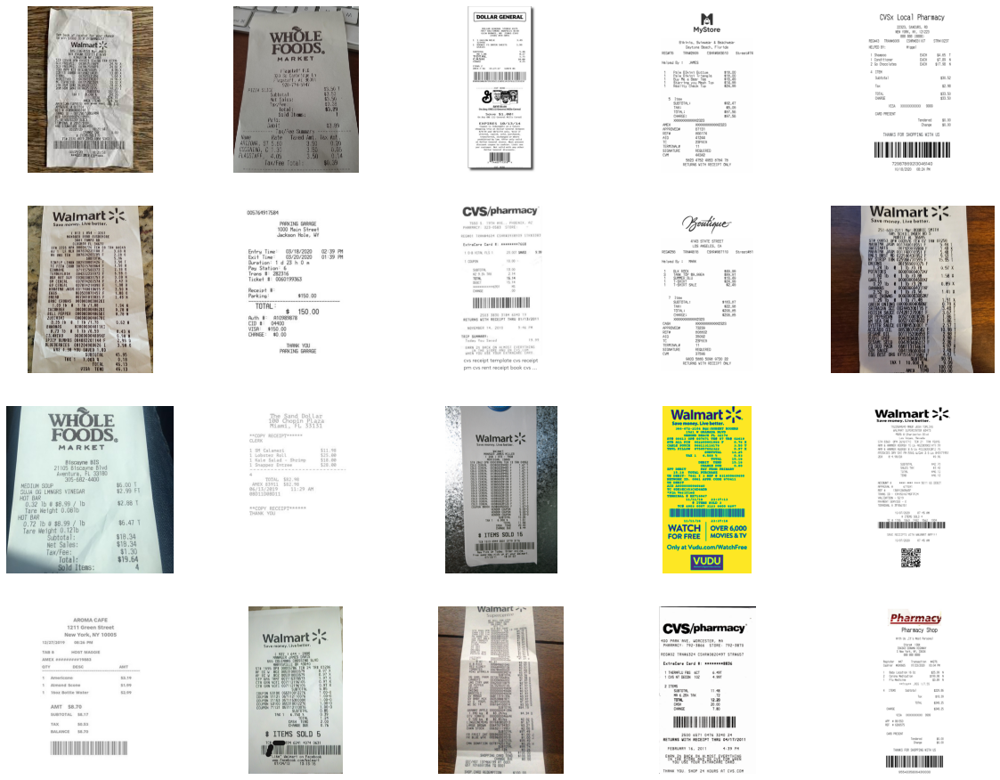

In [5]:
plt.figure(figsize=(20, 20))

for i, image in enumerate(images_path,1):
    plt.subplot(5, 5, i)
    plt.imshow(img.imread(image))
    plt.axis('off')

# Step2. Google OCR API, keras-ocr, Tesseract로 테스트 진행


In [7]:
# keras-ocr이 detector과 recognizer를 위한 모델을 자동으로 다운로드받게 됩니다. 
pipeline = keras_ocr.pipeline.Pipeline()

Looking for /aiffel/.keras-ocr/craft_mlt_25k.h5
Looking for /aiffel/.keras-ocr/crnn_kurapan.h5


In [8]:
images = [keras_ocr.tools.read(im) for im in images_path]
predictions = [pipeline.recognize([im]) for im in images_path]

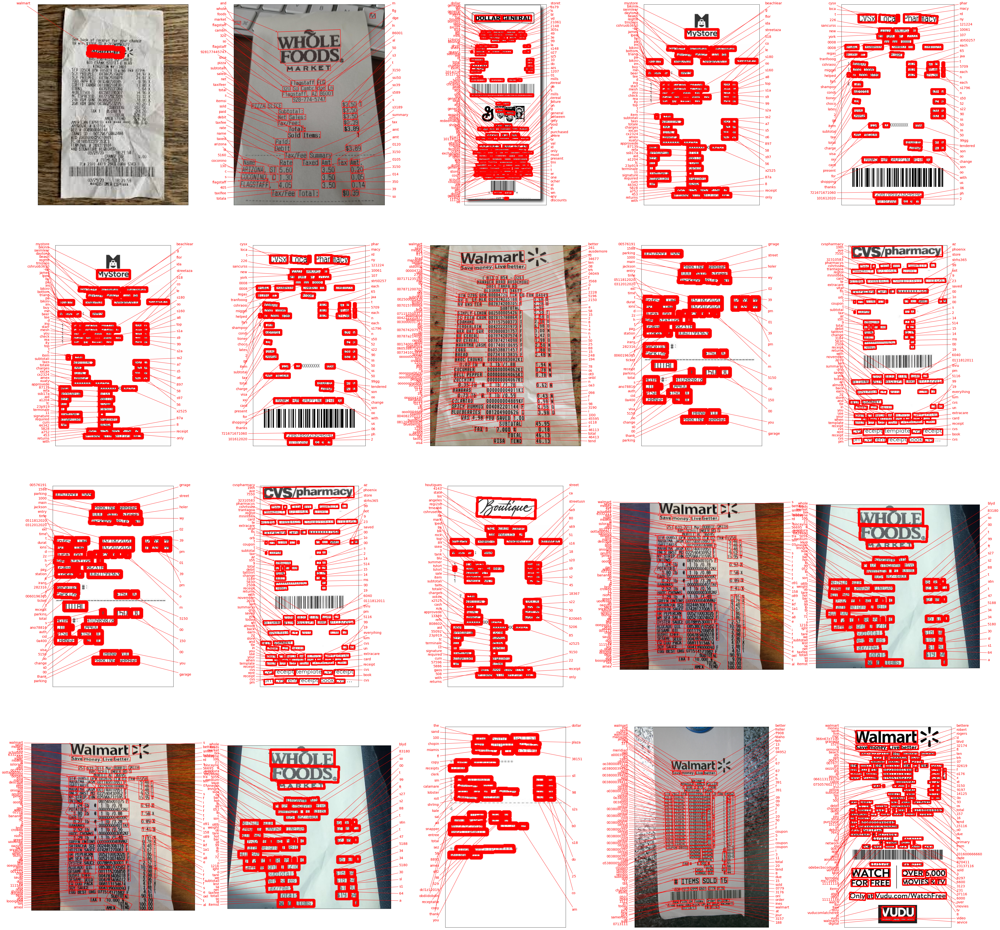

In [53]:
fig, axs = plt.subplots(4, 5, figsize=(70, 70))
for a in range(len(axs)):
    for b in range(len(axs[a])):
        keras_ocr.tools.drawAnnotations(image=images[3*a+b], 
                                    predictions=predictions[3*a+b][0], ax=axs[a,b])

In [10]:
def detect_box(image_path):
    filename = os.path.basename(image_path)
    # read the image and get the dimensions
    img = cv2.imread(image_path)
    img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)

    d = pytesseract.image_to_data(img, output_type=Output.DICT)
    n_boxes = len(d['text'])

    # draw the bounding boxes on the image
    for i in range(n_boxes):
        if int(d['conf'][i]) > 1: # confidence가 1 이상인 값들만
            (x, y, w, h) = (d['left'][i], d['top'][i], d['width'][i], d['height'][i])
            img = cv2.rectangle(img, (x, y), (x + w, y + h), (0, 255, 0), 2)
            text = d['text'][i]
            text = "".join([c if ord(c) < 128 else "" for c in text]).strip()
            cv2.putText(img, text, (x, y - 10), cv2.FONT_HERSHEY_SIMPLEX,
                        1.5, (0, 0, 255), 3)
    return img

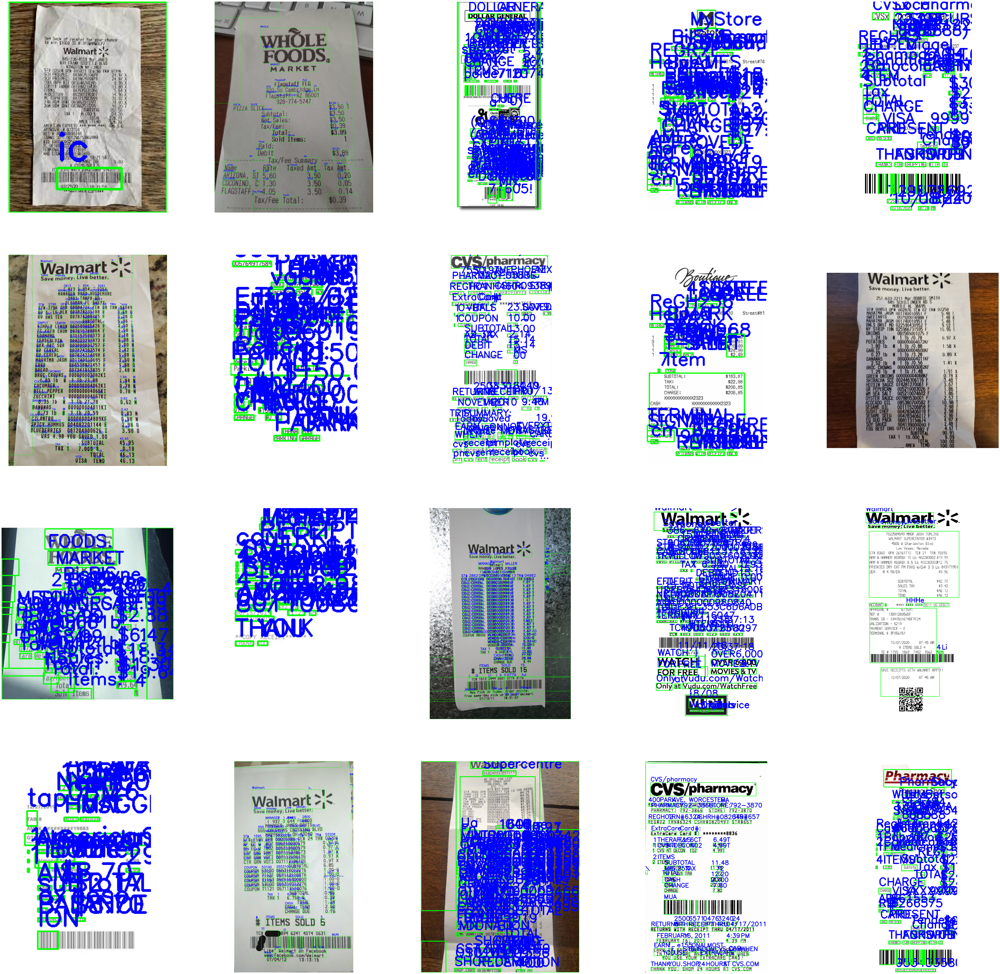

In [55]:
# confidence = 1
plt.figure(figsize=(80, 80))
for i,image_path in enumerate(images_path,1):
    img = detect_box(image_path)
    plt.subplot(4, 5, i)
    plt.imshow(img)
    plt.axis('off')

2) 텍스트 추출 앞서 한 시각화가 눈에 잘 띄지 않아 검출된 텍스트만 별도로 추출해 보기로 했다.
def extract_text(image_path): pytesseract.image_to_string을 사용해 검출된 문자열만 반환하는 함수.

In [12]:
def extract_text(image_path):
    custom_oem_psm_config = r'--oem 3 --psm 11'
    img = cv2.imread(image_path)
    img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
    txt = pytesseract.image_to_string(img, lang='eng',config=custom_oem_psm_config)
    txt = re.sub(r"\n+"," ",txt)
    return txt

In [13]:
extract_text(images_path[1])

'2 a | im |? oJ WHOLE FOODS. MARKET Flagstaff FLG 370 So Cambridge Ln Flagstaff, AZ 86001 928-774-5747 PIZZA SLICE $3.50 | Subtota | $3.50 Net Sales $3.50 Tax/Fee $0.39 Total: $3.89 sold Items; Paid: “Debit $3 83 - Tax/Fee Summary et — = Name Rate Taxed Amt. Tax Amt. ARIZONA, ST 5.60 J. 4 0,05 CUCONING, C 1,30 3.50 FLAGSTAFF, 4.05 3.50 \\4 lax/Fee Total: => ~~ S eS = a a oe a oe ke oe a a a a or oe a ae ae ee a —_— ae \x0c'

In [14]:
for image_path in images_path:
    filename = os.path.basename(image_path)
    txt = extract_text(image_path)
    txt = "".join([c if ord(c) < 128 else "" for c in txt]).strip()
    print(f'========{filename}========')
    print(txt)

========4.jpg========
Wale. ae om wits hs hee rhe np ii in a
========12.jpg========
2 a | im |? oJ WHOLE FOODS. MARKET Flagstaff FLG 370 So Cambridge Ln Flagstaff, AZ 86001 928-774-5747 PIZZA SLICE $3.50 | Subtota | $3.50 Net Sales $3.50 Tax/Fee $0.39 Total: $3.89 sold Items; Paid: Debit $3 83 - Tax/Fee Summary et  = Name Rate Taxed Amt. Tax Amt. ARIZONA, ST 5.60 J. 4 0,05 CUCONING, C 1,30 3.50 FLAGSTAFF, 4.05 3.50 \4 lax/Fee Total: => ~~ S eS = a a oe a oe ke oe a a a a or oe a ae ae ee a _ ae
========9.jpg========
DOLLAR GENERAL sTore# 6579 7077 BALTIMORE ANAPOLTS. BLVD GLEN BURNIE, MO 21061-2143, (C410) 859-3055 1.1 GALLON MILK 3.49 123456 a BOUNCE FS DRYER SHEETS 1.99 654321 susrorat 5.48 MO 5.0% ol27 TOTAL 5.75 CASH 10.00 CHANGE 423 ITEMS 2. 2014-716 1 7 2074 on | | | lI | | 8909830020799: Nn 197612; I CUT HERE ee SAVE $1.00 (On Any ONE (1) General Mills Cereal Save $1.00! (On Any ONE (2) General MiLIS Cereal EXPIRES 10/13/14 Coupon is redeemable on a future shopping trip at Dolla

========1.jpg========
Waimart ~, Supercentr we 35 en oN 633-837-9999 3 as 04336 $4.79 bon79 $98 8 Ky, 8876559 $ 09 88 ts 9 ae reo! 9 $9.00 sgt $3.97 0 $3.97 ON 8533: in 9-ar 50.37. 3 33.0 U.B.RICE 005849601040 $5 37D TOMADTES RED KIDNE v 996684400105 $0 37D 80000223 si 43D MINT WTRMELN 8500983354 IBTOTAL $59 $3 7D 38 HG GARL PARM 00735 7>BEBoe $2 98 D CARROTS 003338366002 si a as, CTRY, WN 006200010879 $2 ot H CELERY SB PEPPER 16 1929500105 si a 0 GNIONS 000000004068K 900000004583K 31 $0 aD 57D BROCCOLI 090000004060k $1 47D GV MANGO 068113191396 $3 97D GV BABY MIX 060538887871 $2 47D Gv 0 YOGPL 062891500035 si 97D wc Sc 14 006164100014 33 00 D SUBTOTAL $84 19 GRANNY APPLE 009090081 89K ory" Toxato 1.340 $4 340 0.720 ki @ 080000042644 $2.80/k9 LINGUINE4546 007680802013 $1 $2 02D LARGE BROWN 006476734301 $3 67D 270 CHKN STOCK 006321119951 $2 00 D TOTAL $97 49 FR FRUIT INT 005s 7016 $1 00 J FR BLUE WTR 005! i 7019 $1 00 J $99 $0 254 $9 HN DONATION ote Re OTAL $100 00 SHOPPING CARD TEND $1

2-3. Google OCR API
def detect_text(path) : 이미지에서 문자를 검출하는 함수.
def draw_boxes(image, bounds, color) : 이미지와 검출된 바운딩 박스 좌표를 받아 검출 영역 시각화.

In [29]:
def detect_text(path):
    """Detects text in the file."""
    from google.cloud import vision
    import io
    client = vision.ImageAnnotatorClient()

    with io.open(path, 'rb') as image_file:
        content = image_file.read()
        
    image = vision.Image(content=content)

    response = client.text_detection(image=image)
    texts = response.text_annotations
    print('Texts :')

    for text in texts:
       print('\n"{}"'.format(text.description))

    vertices = (['({},{})'.format(vertex.x, vertex.y)
                 for vertex in text.bounding_poly.vertices])

    print('bounds: {}'.format(','.join(vertices)))

    if response.error.message:
        raise Exception(
            '{}\nFor more info on error messages, check: '
            'https://cloud.google.com/apis/design/errors'.format(
                response.error.message))

In [26]:
def draw_boxes(image, bounds, color):
    """Draw a border around the image using the hints in the vector list."""
    draw = ImageDraw.Draw(image)

    for bound in bounds:
        draw.polygon([
            bound.vertices[0].x, bound.vertices[0].y,
            bound.vertices[1].x, bound.vertices[1].y,
            bound.vertices[2].x, bound.vertices[2].y,
            bound.vertices[3].x, bound.vertices[3].y], None, color)
    return image

In [22]:
!ls -l $GOOGLE_APPLICATION_CREDENTIALS


-rw-r--r-- 1 root root 2318 Mar  2 11:13 /aiffel/aiffel/ocr_python/nth-gasket-342811-27b84aa0f9d5.json


In [23]:
os.environ["GOOGLE_APPLICATION_CREDENTIALS"] =  os.getenv('HOME')+'/aiffel/ocr_python/nth-gasket-342811-27b84aa0f9d5.json'

In [30]:
for path in images_path:
    print(detect_text(path))

Texts:

"ck at reetet for
chutce
Walmart
8.000
MEXEND
TERMIMCT
18.21:59
"

"ck"

"at"

"reetet"

"for"

"chutce"

"Walmart"

"8.000"

"MEXEND"

"TERMIMCT"

"18.21:59"
bounds: (96,223),(119,223),(119,230),(96,230)
None
Texts:

"B.
ond
WHÖLE
FOODS,
MARKET
Flagstaff FLG
320 So Cambridge Ln
Flagstaff, AZ 86001
928-774-5747
$3.50 T
$3.50
$3.50
$0.39
$3.89
1.
PIZZA SLICE
Subtotal:
Net Sales:
Tax/Fee:
Total:
Sold Items:
Paid:
Debit
- Tax/Fee Summary
Rate Taxed Amt. Tax Amt.
$3.89
Name
ARIZONA, ST 5.60
COCONINO, C 1.30
FLAGSTAFF, 4.05
3.50 0.20
3.50 0.05
3.50 0.14
$0.39
Tax/Fee Total:
"

"B."

"ond"

"WHÖLE"

"FOODS,"

"MARKET"

"Flagstaff"

"FLG"

"320"

"So"

"Cambridge"

"Ln"

"Flagstaff,"

"AZ"

"86001"

"928-774-5747"

"$3.50"

"T"

"$3.50"

"$3.50"

"$0.39"

"$3.89"

"1."

"PIZZA"

"SLICE"

"Subtotal:"

"Net"

"Sales:"

"Tax/Fee:"

"Total:"

"Sold"

"Items:"

"Paid:"

"Debit"

"-"

"Tax/Fee"

"Summary"

"Rate"

"Taxed"

"Amt."

"Tax"

"Amt."

"$3.89"

"Name"

"ARIZONA,"

"ST"

"5.60"

"C

Texts:

"CVS/pharmacy
7550 S. 19TH AVE., PHOENIX, AZ
PHARMACY: 323-0583 STORE:
REG#01 TRAN#4604 CSHR#0938939 STR#3383
ExtraCare Card #: ********7668
1 0-B VITAL FLS 1
23.00T SAVED
9.99
1 COUPON
10.00 -
SUBTOTAL
13.00
AZ 9.3% TAX
2.14
15.14
15.14
TOTAL
DEBIT
************6901
MS
CHANGE
.00
2503 3830 3184 6040 19
RETURNS WITH RECEIPT THRU 01/13/2011
NOVEMBER 14, 2010
9:46 PM
TRIP SUMMARY:
Today You Saved
19.99
EARN 2% BACK ON ALMOST EVERYTHING
IN THE SIORE ANU ON CVS.COM
WHEN YOU USE YOUR EXTRACARE CARD
cvs receipt template cvs receipt
pm cvs rent receipt book cvs ...
"

"CVS/pharmacy"

"7550"

"S."

"19TH"

"AVE.,"

"PHOENIX,"

"AZ"

"PHARMACY:"

"323-0583"

"STORE:"

"REG#01"

"TRAN#4604"

"CSHR#0938939"

"STR#3383"

"ExtraCare"

"Card"

"#:"

"********7668"

"1"

"0-B"

"VITAL"

"FLS"

"1"

"23.00T"

"SAVED"

"9.99"

"1"

"COUPON"

"10.00"

"-"

"SUBTOTAL"

"13.00"

"AZ"

"9.3%"

"TAX"

"2.14"

"15.14"

"15.14"

"TOTAL"

"DEBIT"

"************6901"

"MS"

"CHANGE"

".00"

"2503"

"3830

Texts:

"Walmart >*
Save money. Live better.
386-672 - 2104 Mgr: ROBERT ROGERS
1521 W GRANADA BLVD
ORMOND BEACH FL 32174
ST# 00613 OP# 007671 TE# 07 TR# 02 619
STB ALL PIN
002200001988 F
0.78 X
CABLE POUCH
068113118178
3.50 T
TRVL PILLOW
075057602322
9.97 X
SUBTOTAL
14.25
6.500 %
ТОTAL
ТАХ 1
0.93
15.18
TEND
CHANGE DUE
DEBIT
15.18
0.00
EFT DEBIT
PAY FROM PRIMARY
15.18
TOTAL PURCHASE
US DEBIT- 7641 I 3 REF # 831600869690
NETWORK ID.
US DEBIT
0081 APPR CODE 870411
AID A0000000980840
TC 9DE3EC353C6D6ADB
*Pin Verified
TERMINAL # MX716047
11/11/18
23:37:13
# ITEMS SOLD 3
TC# 4903 0007 3123 6600 8297
11/11/18
23:37:18
WATCH
OVER 6,000
FOR FREE
MOVIES & TV
Only at Vudu.com/WatchFree
VUDU
Walmart's Digital Video Service
"

"Walmart"

">*"

"Save"

"money."

"Live"

"better."

"386-672"

"-"

"2104"

"Mgr:"

"ROBERT"

"ROGERS"

"1521"

"W"

"GRANADA"

"BLVD"

"ORMOND"

"BEACH"

"FL"

"32174"

"ST#"

"00613"

"OP#"

"007671"

"TE#"

"07"

"TR#"

"02"

"619"

"STB"

"ALL"

"PIN"

"002200001988"

"

Texts:

"CVS/pharmacy
400 PARK 'AVE, WORCESTER, MA
PHARMACY: 792-3866 STORE: 792-3870
REG#02 TRN#6324 CSHR#0820497 STR#657
ExtraCare Card #: ********8836
1 THERAFLU F&S 6CT
6.49T
1 CVS NT DECON 10Z
4.99T
2 ITEMS
SUBTOTAL
11.48
MA 6.25% TAX
TOTAL
CASH
.72
12.20
20.00
CHANGE
7.80
2500 6571 0476 3240 24
RETURNS WITH RECEIPT THRU 04/17/2011
FEBRUARY 16, 2011
4:39 PM
EARN 2% BACK ON ALMOSI EVERYTHING
IN IHE SIORE AND ON CVS COM WHEN
YOU UŠE YÕUR EXTRACARE CARD.
THANK YOU. SHOP 24 HOURS AT CVS.COM
"

"CVS/pharmacy"

"400"

"PARK"

"'AVE,"

"WORCESTER,"

"MA"

"PHARMACY:"

"792-3866"

"STORE:"

"792-3870"

"REG#02"

"TRN#6324"

"CSHR#0820497"

"STR#657"

"ExtraCare"

"Card"

"#:"

"********8836"

"1"

"THERAFLU"

"F&S"

"6CT"

"6.49T"

"1"

"CVS"

"NT"

"DECON"

"10Z"

"4.99T"

"2"

"ITEMS"

"SUBTOTAL"

"11.48"

"MA"

"6.25%"

"TAX"

"TOTAL"

"CASH"

".72"

"12.20"

"20.00"

"CHANGE"

"7.80"

"2500"

"6571"

"0476"

"3240"

"24"

"RETURNS"

"WITH"

"RECEIPT"

"THRU"

"04/17/2011"

"FEBRUARY"


In [32]:
def detect_text_2(path):
    """Detects text in the file."""
    text_dec = []
    bounds = []
    client = vision.ImageAnnotatorClient()
    
    with io.open(path, 'rb') as image_file:
        content = image_file.read()
    
    name = os.path.basename(path)
    
    image = vision.Image(content=content)

    response = client.text_detection(image=image)
    texts = response.text_annotations

    for text in texts:
        text_dec.append(text.description.replace('\n',''))
        vertices = text.bounding_poly
        bounds.append(vertices)
    
    if response.error.message:
        raise Exception(
            '{}\nFor more info on error messages, check: '
            'https://cloud.google.com/apis/design/errors'.format(
                response.error.message))
        
    return name, text_dec, bounds

In [33]:
ocr_img = []
ocr_dict = {}
# 위에서 정의한 OCR API 이용 함수를 호출해 봅시다.
for path in images_path:
    name, text_dec, bounds = detect_text_2(path)
    ocr_dict[name] = text_dec
    image = Image.open(path)
    draw_boxes(image, bounds, 'red')
    ocr_img.append(image)

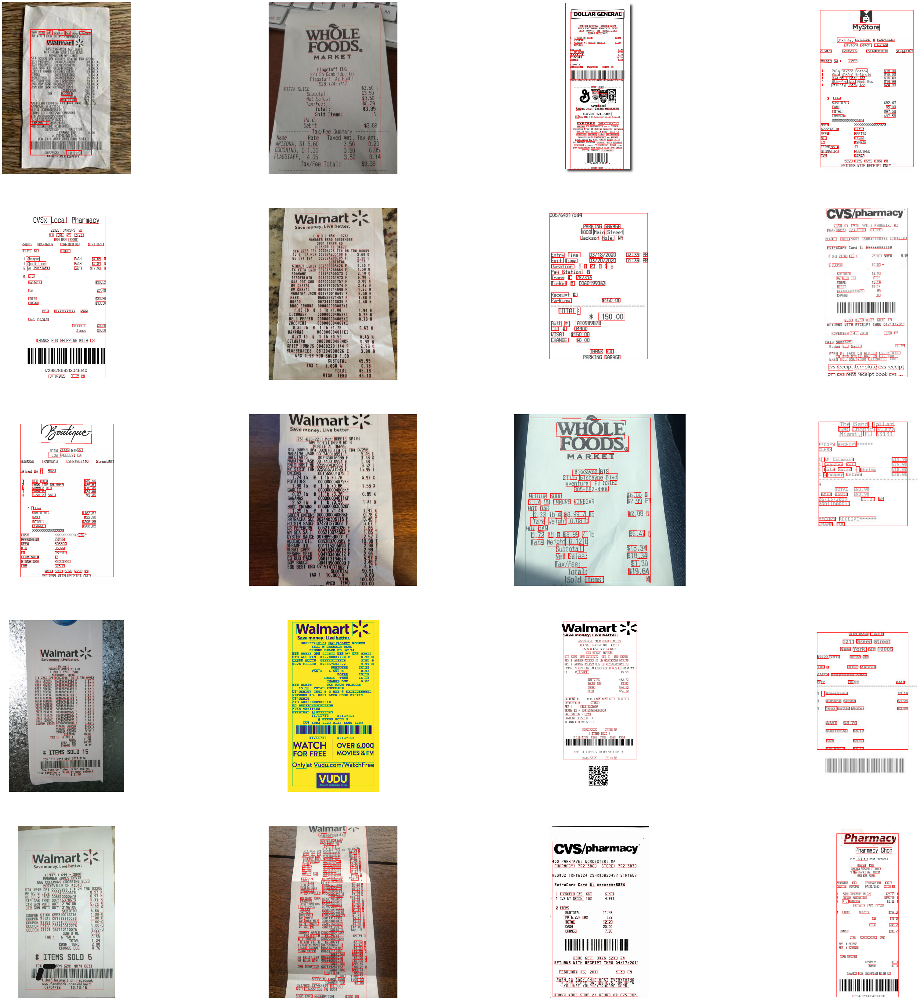

In [67]:
plt.figure(figsize=(60, 60))

for i, img in enumerate(ocr_img, 1):
    plt.subplot(5, 4, i)
    plt.imshow(img)
    plt.axis('off')

## test 결과정리
- 전처리 안된 이미지와 전처리 된 이미지를 비교 

### keras_ocr

In [74]:
def show_keras(num):
    fig, axs = plt.subplots(1, 1, figsize=(20, 20))
    keras_ocr.tools.drawAnnotations(image=images[num], predictions=predictions[num][0], ax=axs)

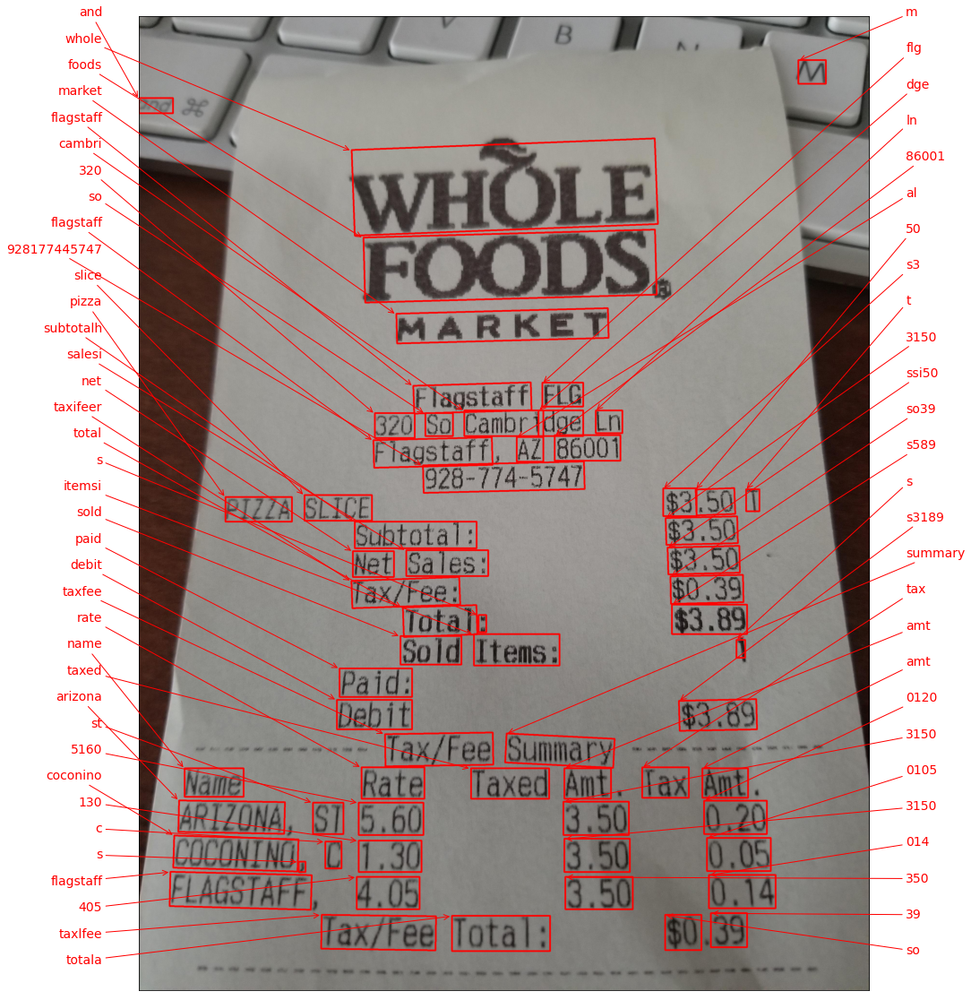

In [75]:
show_keras(1)

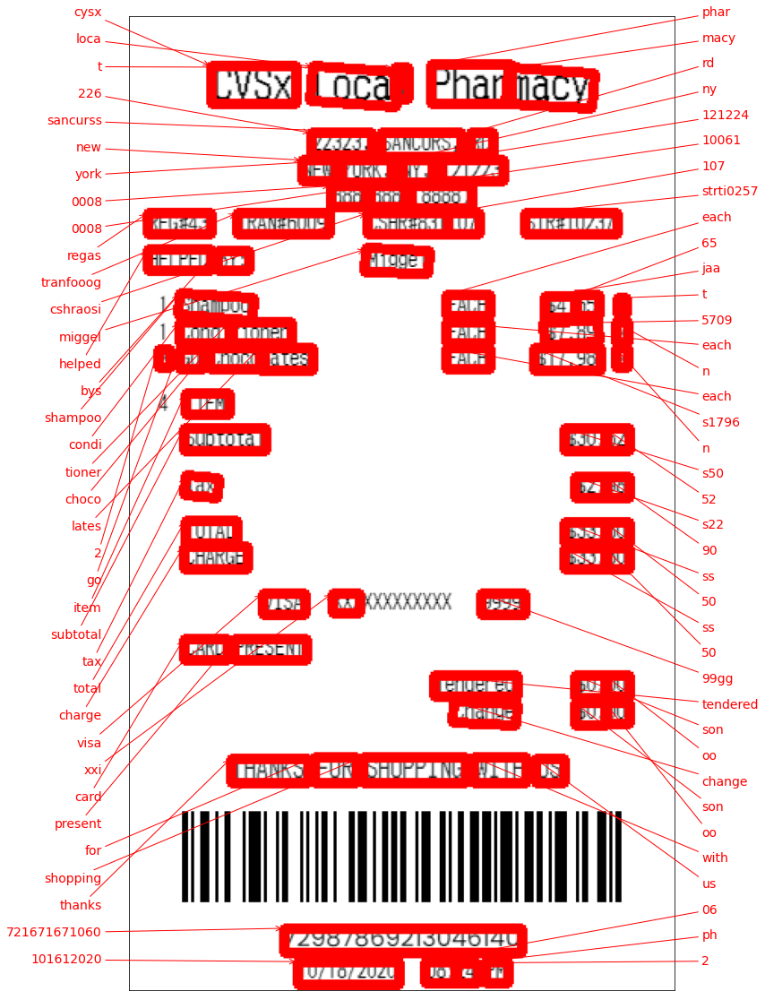

In [76]:
show_keras(4)

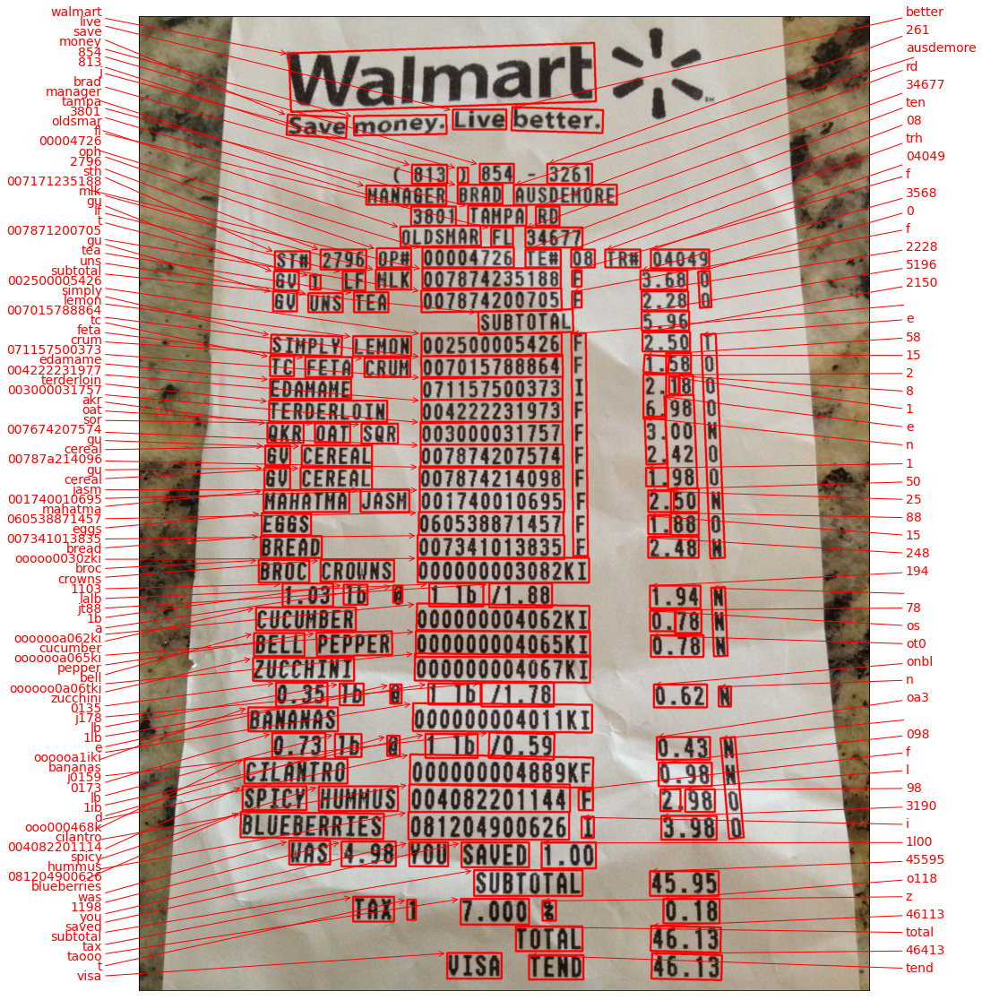

In [77]:
show_keras(5)

- 영단어 ocr은 준수한데 특수문자에 대해선 못읽는다.(전처리된 이미지든 아니든 상관없음)
- 영수증에선 /와 같은 특수문자 구분을 잘해야 후처리가 편할텐데 약간 아쉽다.

## Tesseract 

In [80]:
def show_tesseract(num):
    plt.figure(figsize=(50, 50))

    plt.subplot(121)
    org = cv2.imread(images_path[num])
    org = cv2.cvtColor(org, cv2.COLOR_BGR2RGB)
    plt.imshow(org)
    plt.title('Original')
    plt.subplot(122)
    img = detect_box(images_path[num])
    plt.imshow(img)
    plt.title('Detected')
    txt = extract_text(images_path[num])
    print(txt)

2 a | im |? oJ WHOLE FOODS. MARKET Flagstaff FLG 370 So Cambridge Ln Flagstaff, AZ 86001 928-774-5747 PIZZA SLICE $3.50 | Subtota | $3.50 Net Sales $3.50 Tax/Fee $0.39 Total: $3.89 sold Items; Paid: “Debit $3 83 - Tax/Fee Summary et — = Name Rate Taxed Amt. Tax Amt. ARIZONA, ST 5.60 J. 4 0,05 CUCONING, C 1,30 3.50 FLAGSTAFF, 4.05 3.50 \4 lax/Fee Total: => ~~ S eS = a a oe a oe ke oe a a a a or oe a ae ae ee a —_— ae 


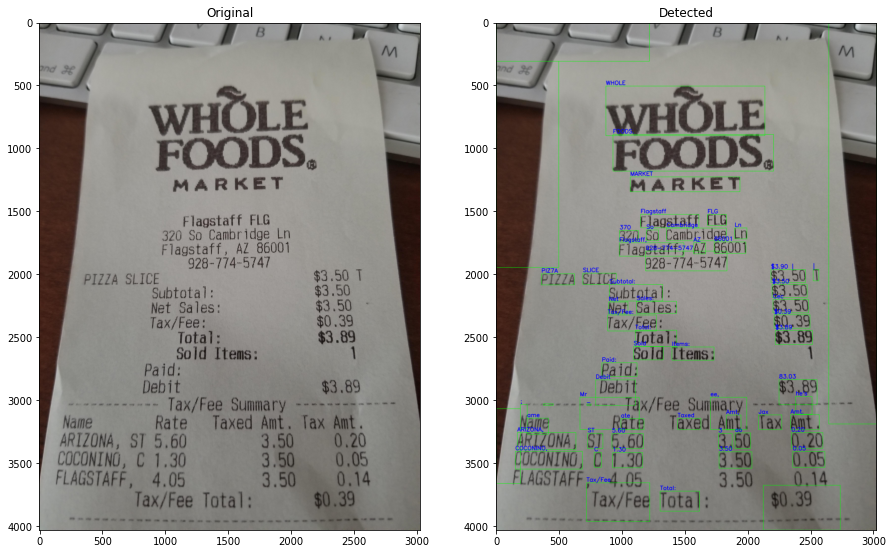

In [57]:
show_tesseract(1)

Walmart > x. Save money. Live better. ( 3 ) 634 - 3261 a7 MANAGER BRAD AUSDEMORE 3801 A RD OLDSHAR FL 34677 aed STH 2796 OP# 00004726 TE# 08 TR# 04049 GU 1 LF MLK 007874235188 F GU UNS TEA 007874200705 F .28 0 SU TAL 96 SIMPLY LEMON 002500005426 50 T TC FETA CRUM 007015788864 38 0 EDAMANE 071157500373 18 0 TERDERLOIN 004222231973 98 9 00 K gf GU CEREAL QKR OAT SQR 003000031757 42 0 GY CEREAL 007874214098 007874207574 96 0 MAHATHA JASH 001740010695 30 K G&S 060538871457 86 0 EAD 007341013835 48 i BROC CROWNS 000000003082KI 1 a 1b Lt 8 94 N CUCUMBER 000000004062KI 78 4 BELL PEPPER 000000004065KI 78 N ZUCCHINI 000000004067KI 1] 0.35 Ib @ /1. 0.62 N BANANAS 000000004011KI 0.73 Ib @ 1 1b /0.59 0.43 4 CILANTRO 000000004889KF 0.98 N SPICY HUMMUS 004082201144 F 2.98 0 BLUEBERRIES 081204900626 I 3.98 0 WAS 4.96 YOU SAVED 1.00 SUBTOTAL 45.95 TAX 1 7.000 % 0.18 46.13 VISA TEND 46.13 


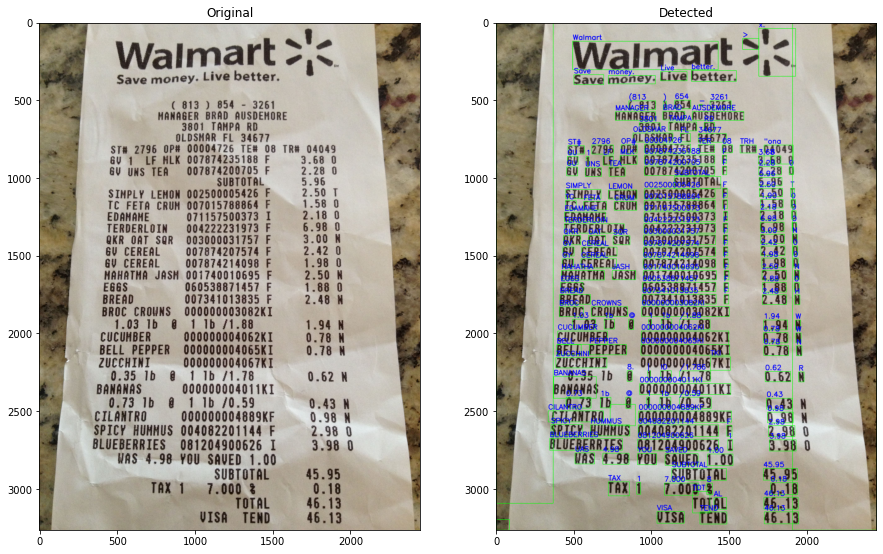

In [58]:
show_tesseract(5)

CVSx Local Pharmacy 22323, SANCURS, NEW YORK, NY, 121223 888 888 (8888) REGHAS TRAN#6009 CSHR#831 107 ‘STR#10237 HELPED BY: Miggel 1 Shampoo EACH $4.65 T 1 Conditioner EACH $7.89 N 2 Go Chocolates EACH $17.98 N 4 ITEM Subtotal $30.52 Tax $2.98 TOTAL $33.50 CHARGE $33.50 VISA OOKHKAHOXXK 9999 CARD PRESENT Tendered $0.00 Change $0.00 THANKS FOR SHOPPING WITH US ll | | | | | | it tl 72987869213046140 10/18/2020 08:24 PH 


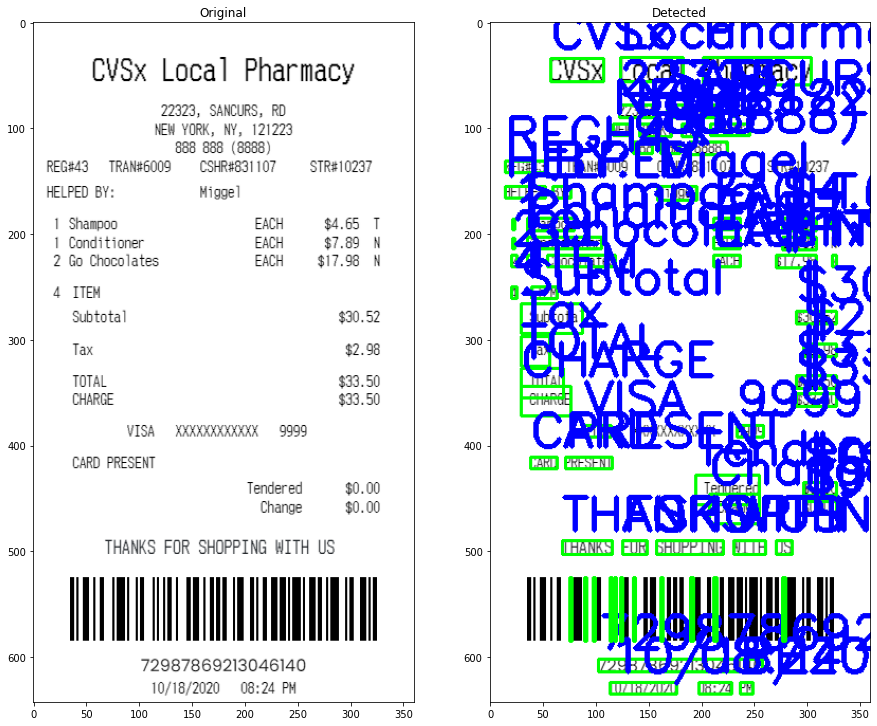

In [78]:
show_tesseract(4)

- 전처리 되지않은 이미지에 대해선 ocr은 keras가 더 좋은거같다.
- 특수문자 확인은 tesseract가 더 낫다.
- 전처리로 노이즈 제거, 엣지관련 필터링을 먹이고 어핀변환을 해줘야할것같다.

## Google Api

In [63]:
def show_google(num):
    name, text_dec, bounds = detect_text_2(images_path[num])
    image = Image.open(images_path[num])
    detect_text(images_path[num])
    plt.figure(figsize=(15, 15))
    plt.subplot(121)
    org = image
    plt.imshow(org)
    plt.title('Original')
    plt.subplot(122)
    img = draw_boxes(image, bounds, 'red')
    plt.imshow(img)
    plt.title('Detected')
    print(text_dec[0])


Texts:

"B.
ond
WHÖLE
FOODS,
MARKET
Flagstaff FLG
320 So Cambridge Ln
Flagstaff, AZ 86001
928-774-5747
$3.50 T
$3.50
$3.50
$0.39
$3.89
1.
PIZZA SLICE
Subtotal:
Net Sales:
Tax/Fee:
Total:
Sold Items:
Paid:
Debit
- Tax/Fee Summary
Rate Taxed Amt. Tax Amt.
$3.89
Name
ARIZONA, ST 5.60
COCONINO, C 1.30
FLAGSTAFF, 4.05
3.50 0.20
3.50 0.05
3.50 0.14
$0.39
Tax/Fee Total:
"

"B."

"ond"

"WHÖLE"

"FOODS,"

"MARKET"

"Flagstaff"

"FLG"

"320"

"So"

"Cambridge"

"Ln"

"Flagstaff,"

"AZ"

"86001"

"928-774-5747"

"$3.50"

"T"

"$3.50"

"$3.50"

"$0.39"

"$3.89"

"1."

"PIZZA"

"SLICE"

"Subtotal:"

"Net"

"Sales:"

"Tax/Fee:"

"Total:"

"Sold"

"Items:"

"Paid:"

"Debit"

"-"

"Tax/Fee"

"Summary"

"Rate"

"Taxed"

"Amt."

"Tax"

"Amt."

"$3.89"

"Name"

"ARIZONA,"

"ST"

"5.60"

"COCONINO,"

"C"

"1.30"

"FLAGSTAFF,"

"4.05"

"3.50"

"0.20"

"3.50"

"0.05"

"3.50"

"0.14"

"$0.39"

"Tax/Fee"

"Total:"
bounds: (1304,3733),(1679,3731),(1680,3858),(1305,3860)
B.ondWHÖLEFOODS,MARKETFlagstaff FLG320 

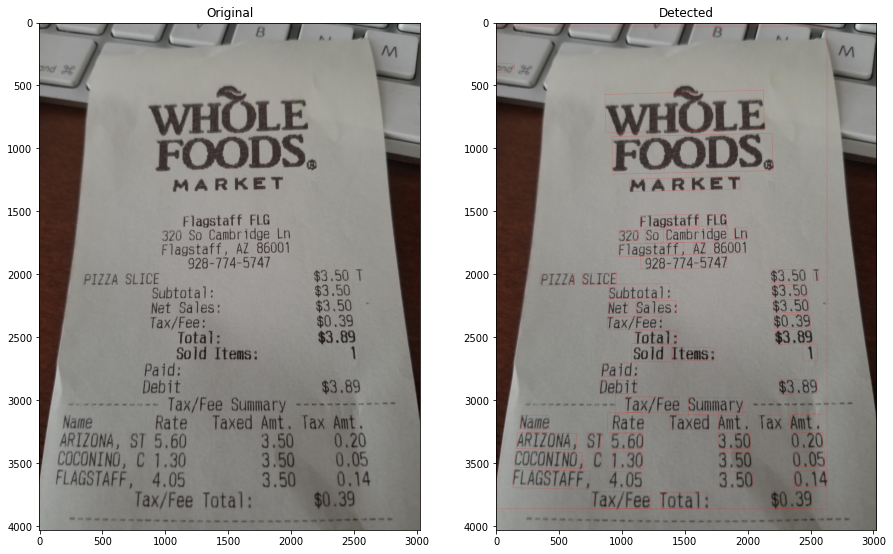

In [64]:
show_google(1)

Texts:

"Walmart >*
SM
Save money. Live better.
( 813 ) 854 - 3261
HANAGER BRAD AUSDEMORE
3801 TAMPA RD
OLDSHAR FL 34677
GV 1 LF MLK 007874235188 F
GV UNS TEA 007874200705 F
SUBTOTAL
SIMPLY LEMON 002500005426 F
TC FETA CRUM 007015788864 F
EDAMAME 071157500373 I
TERDERLOIN 004222231973 F
QKR OAT SQR 003000031757 F
GV CEREAL 007874207574 F
GV CEREAL 007874214098 F
MAHATHA JASH 001740010695 F
060538871457 F
007341013835 F
BROC CROWNS 000000003082KI
1.03 lb @ 1 lb /1.88
ST# 2796 OP# 00004726 TE# 08 TR# 04049
3.68 O
2.28 0
5.96
2.50 T
1.58 O
2.18 0
6.98 O
3.00 N
2.42 O
1.98 0
2.50 N
1.88 0
2.48 N
EGGS
BREAD
1.94 N
00 0000004062KI 0.78 N
0.78 N
CUCUMBER
BELL PEPPER 000000004065KI
ZUCCHINI 000000004067KI
0.35 lb @ 1 lb /1.78
000000004011KI
0.73 lb @ 1 lb /0.59
000000004889KF
0.62 N
BANANAS
0.43 N
0.98 N
SPICY HUMMUS 004082201144 F 2.98 O
BLUEBERRIES 081204900626 I 3.98 O
CILANTRO
WAS 4.98 YOU SAVED 1.00
SUBTOTAL
TAX 1 7.000 %
TOTAL
VISA TEND
45.95
0.18
46.13
46.13
"

"Walmart"

">*"

"SM"

"S

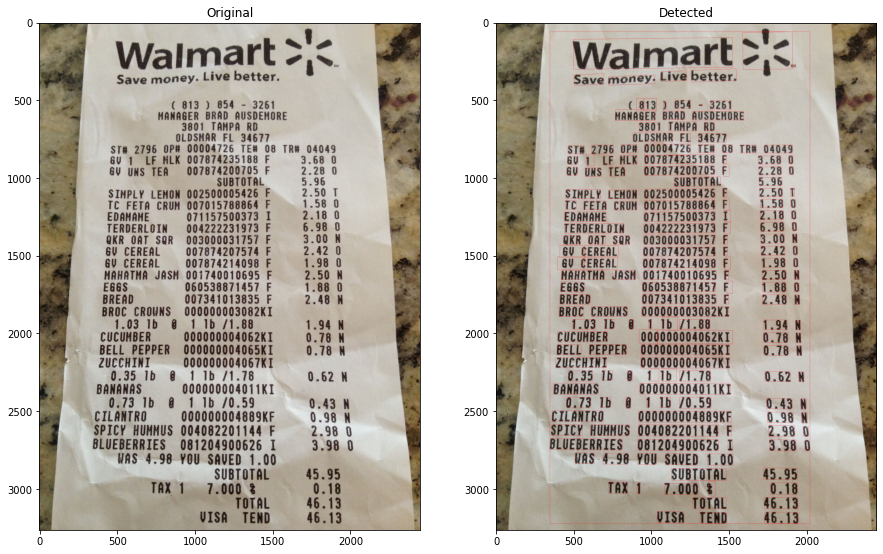

In [66]:
show_google(5)

Texts:

"CVSX Local Pharmacy
22323, SANCURS, RD
NEW YORK, NY, 121223
888 888 (8888)
REG#43 TRAN#6009
CSHR#831107
STR#10237
HELPED BY:
Miggel
1 Shampoo
1 Conditioner
2 Go Chocolates
EACH
EACH
EACH
$4.65 T
$7.89 N
$17.98 N
4 ITEM
Subtotal
$30.52
Tax
$2.98
ТОTAL
$33.50
$33.50
CHARGE
VISA XXXXXXXXXКХХ 999
CARD PRESENT
Tendered
$0.00
$0.00
Change
THANKS FOR SHOPPING WITH US
72987869213046140
10/18/2020 08:24 PM
"

"CVSX"

"Local"

"Pharmacy"

"22323,"

"SANCURS,"

"RD"

"NEW"

"YORK,"

"NY,"

"121223"

"888"

"888"

"(8888)"

"REG#43"

"TRAN#6009"

"CSHR#831107"

"STR#10237"

"HELPED"

"BY:"

"Miggel"

"1"

"Shampoo"

"1"

"Conditioner"

"2"

"Go"

"Chocolates"

"EACH"

"EACH"

"EACH"

"$4.65"

"T"

"$7.89"

"N"

"$17.98"

"N"

"4"

"ITEM"

"Subtotal"

"$30.52"

"Tax"

"$2.98"

"ТОTAL"

"$33.50"

"$33.50"

"CHARGE"

"VISA"

"XXXXXXXXXКХХ"

"999"

"CARD"

"PRESENT"

"Tendered"

"$0.00"

"$0.00"

"Change"

"THANKS"

"FOR"

"SHOPPING"

"WITH"

"US"

"72987869213046140"

"10/18/2020"

"08:24"



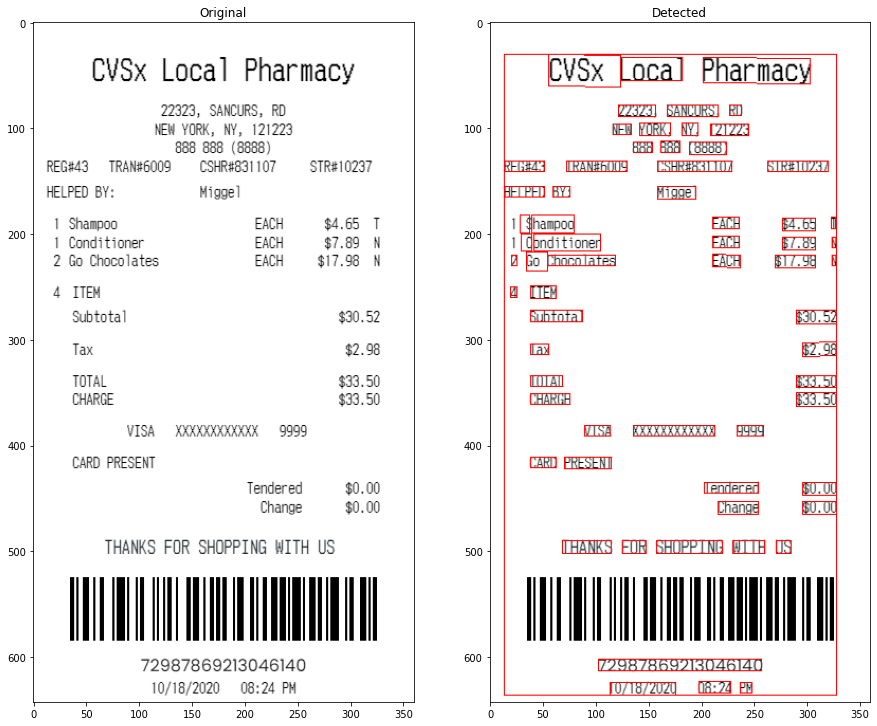

In [79]:
show_google(4)

- ocr 성능이 가장 좋다.
- 특수문자도 확인을 잘한다.
- 전처리를 하면 성능이 더 좋아지긴 하는듯


### 결론
- 성능 자체는 구글 api가 가장좋다.하지만 유료다.
- 비용측면에서 문제가 있을 것 같으면 tesseract를 쓰고 , 전처리를 잘하면 될듯하다.(노이즈 캔슬, 라
### 회고
- 이미